<a href="https://colab.research.google.com/github/compi1234/pyspch/blob/master/test/audio_test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## IPYWIDGET Play Buttons

Date: 17/05/2021, 20/09/2021, 21/09/2021

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt

from IPython.display import display, clear_output, Audio, HTML
import ipywidgets as widgets
import numpy as np
import time
import librosa
try:
  import google.colab
  IN_COLAB = True 
  ! pip install git+https://github.com/compi1234/pyspch.git
except:
  IN_COLAB = False

# verify the IPython version
import IPython
if IPython.version_info[0] >= 6:
    Audio_args = {'normalize':False}
else:
    print("Warning: you are using IPython<6 \n IPython.display.Audio() will automatically normalize audio output")
    Audio_args = {}
import pyspch.audio as Spa
import pyspch.spg as Sps
import pyspch.display as Spd

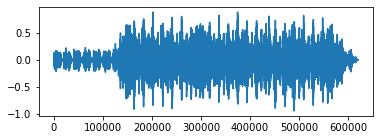

In [3]:
SAMPLE_WAV_URL = 'https://homes.esat.kuleuven.be/~spchlab/data/misc/train.wav'
SAMPLE_WAV_URL = 'https://homes.esat.kuleuven.be/~spchlab/data/13dB/Psnger22.wav'
#
wavdata,sr= Spa.load(SAMPLE_WAV_URL) 
fig = plt.figure(figsize=(6,2))
plt.plot(wavdata)
display(Audio(data=wavdata,rate=sr,autoplay=False,**Audio_args))

In [4]:
Spa.play(wavdata,sr,wait=False)
time.sleep(1)
Spa.stop()

In [39]:
Symbols = { 'play':'\u25b6','reverse':'\u25C0' , 'pause':'\u23F8', 'stop': '\u23F9', 'record':'\u2b55'}
def box_layout(width='',padding='1px',margin='1px',border='solid 1px black'):
     return widgets.Layout(
        border= border,
        padding = padding,      # padding='2px 2px 2px 2px',    white space inside: top, right, bottom, left
        margin=   margin,       # margin = '1px 1px 1px 1px',   white space around the outside
        width = width
     )
def button_layout():
    return widgets.Layout(
        border='solid 1px black',
        margin='5px 5px 5px 5px',
        padding='5px 5px 5px 5px',
        width = '40px',
        height = '40px',
        flex_shrink =2
     )
class PlayButton(widgets.HBox):
    def __init__(self,data,sample_rate=8000,mode=1,width='30%'):
        super().__init__()
        self.data = data
        self.sample_rate = sample_rate
        self.wg_play_button = widgets.Button(description=Symbols['play'],layout=button_layout())
        self.out = widgets.Output(layout=widgets.Layout(width='90%'))
        self.audio = widgets.Output()
        self.wg_play_button.on_click(self.play_sound)
        self.wg_pause_button = widgets.Button(description=Symbols['pause'],layout=button_layout())
        self.wg_pause_button.on_click(self.pause_sound)
        self.layout= box_layout(width=width)
        self.mode = mode
        
        with self.out:
            if mode ==0 :
                fig = None
            elif mode == 1:
                fig=Spd.PlotWaveform(self.data,sample_rate=self.sample_rate,xlabel=None,xticks=None,yticks=False,figsize=(10,5))
            elif mode ==2 :
                spg = Sps.spectrogram(self.data,sample_rate=self.sample_rate)
                fig=Spd.PlotSpg(spgdata=spg,sample_rate=self.sample_rate,figsize=(10,6))
                fig.axes[0].set_yticks([])
            elif mode ==3 :
                spg = Sps.spectrogram(self.data,sample_rate=self.sample_rate)
                fig=Spd.PlotSpg(wavdata=self.data,spgdata=spg,sample_rate=self.sample_rate,figsize=(10,6))
            display(fig)
        if mode == 0:
            self.children = [self.wg_play_button, self.wg_pause_button] 
        else: 
            self.children = [widgets.VBox([self.wg_play_button, self.wg_pause_button],layout=widgets.Layout(width='25%')), self.out] 
        
    def play_sound(self,b):
        with self.audio:
            #clear_output()
            if(IN_COLAB):
              print("IN_COLAB: Use the HTML button to play sound")
            Spa.play(self.data,sample_rate=self.sample_rate,wait=False)
            
    def pause_sound(self,b):
        with self.out:
            Spa.stop()
        
    
pb0=PlayButton(data=wavdata,sample_rate=sr,mode=0,width='100px')                
pb1=PlayButton(data=wavdata,sample_rate=sr,mode=1,width='20%')
pb2=PlayButton(data=wavdata,sample_rate=sr,mode=2,width='40%')
pb3=PlayButton(data=wavdata,sample_rate=sr,mode=3,width='75%')
display(pb0, pb1, pb2, pb3)

PlayButton(children=(Button(description='▶', layout=Layout(border='solid 1px black', height='40px', margin='5p…

PlayButton(children=(VBox(children=(Button(description='▶', layout=Layout(border='solid 1px black', height='40…

PlayButton(children=(VBox(children=(Button(description='▶', layout=Layout(border='solid 1px black', height='40…

PlayButton(children=(VBox(children=(Button(description='▶', layout=Layout(border='solid 1px black', height='40…